## Cheatsheet: HOUSE PRICE PREDICTION USING TEXT AND IMAGES 


#### CSC 180 Intelligent Systems

#### Dr. Haiquan Chen, California State University, Sacramento




#### Notice: In this cheatsheet, I used OpenCV, one of the most popular python libraries for image processing.   You may use the code in this notebook to create images ready for traning. 

To install OpenCV, use:   ***pip install opencv-python***



## import libraries

In [1]:
import seaborn as sns
import os
import pandas as pd
import matplotlib.pyplot as plt

import csv
import numpy as np
%matplotlib inline

import cv2
import glob
from IPython.display import Image

## Load dataset

In [7]:
filename_read = os.path.join("Houses dataset/Houses dataset/HousesInfo.txt")

In [8]:
cols=["Bedrooms","Bathrooms","area","zipcode","price"]

In [9]:
df = pd.read_csv(filename_read , sep=" ", header=None , names=cols)

In [27]:
df.head()

,Bedrooms,Bathrooms,area,zipcode,price
0,4,4.0,4053,85255,869500.0
1,4,3.0,3343,36372,865200.0
2,3,4.0,3923,85266,889000.0
3,5,5.0,4022,85262,910000.0
4,3,4.0,4116,85266,971226.0


In [28]:
df.shape

(535, 5)

## Handling Images dataset

In [33]:
## Bathroom.jpg
new_images=[]
for number in range(1, 536):
    for path in glob.glob("Houses dataset/Houses dataset/" + str(number) + "_bathroom.jpg"):
        if os.path.isfile(path):
            new_images.append(path) 

In [35]:
new_images

['Houses dataset/Houses dataset/1_bathroom.jpg',
 'Houses dataset/Houses dataset/2_bathroom.jpg',
 'Houses dataset/Houses dataset/3_bathroom.jpg',
 'Houses dataset/Houses dataset/4_bathroom.jpg',
 'Houses dataset/Houses dataset/5_bathroom.jpg',
 'Houses dataset/Houses dataset/6_bathroom.jpg',
 'Houses dataset/Houses dataset/7_bathroom.jpg',
 'Houses dataset/Houses dataset/8_bathroom.jpg',
 'Houses dataset/Houses dataset/9_bathroom.jpg',
 'Houses dataset/Houses dataset/10_bathroom.jpg',
 'Houses dataset/Houses dataset/11_bathroom.jpg',
 'Houses dataset/Houses dataset/12_bathroom.jpg',
 'Houses dataset/Houses dataset/13_bathroom.jpg',
 'Houses dataset/Houses dataset/14_bathroom.jpg',
 'Houses dataset/Houses dataset/15_bathroom.jpg',
 'Houses dataset/Houses dataset/16_bathroom.jpg',
 'Houses dataset/Houses dataset/17_bathroom.jpg',
 'Houses dataset/Houses dataset/18_bathroom.jpg',
 'Houses dataset/Houses dataset/19_bathroom.jpg',
 'Houses dataset/Houses dataset/20_bathroom.jpg',
 'Houses 

In [36]:
img= pd.DataFrame(new_images,columns = ['bathroom_img'])

In [38]:
## bedroom images
bedroom_images = []
for number in range(1, 536):
    for path in glob.glob("Houses dataset/Houses dataset/" + str(number) + "_bedroom.jpg"):
        if os.path.isfile(path):
            bedroom_images.append(path) 

In [39]:
img['bedroom_img']=bedroom_images

In [41]:
frontal_images = []
for number in range(1, 536):
    for path in glob.glob("Houses dataset/Houses dataset/" + str(number) + "_frontal.jpg"):
        if os.path.isfile(path):
            frontal_images.append(path) 

In [42]:
img['frontal_img']=frontal_images

In [43]:
kitchen_images = []
for number in range(1, 536):
    for path in glob.glob("Houses dataset/Houses dataset/" + str(number) + "_kitchen.jpg"):
        if os.path.isfile(path):
            kitchen_images.append(path) 

In [44]:
img['kitchen_img']=kitchen_images

In [46]:
img.head()

,bathroom_img,bedroom_img,frontal_img,kitchen_img
0,Houses dataset/Houses dataset/1_bathroom.jpg,Houses dataset/Houses dataset/1_bedroom.jpg,Houses dataset/Houses dataset/1_frontal.jpg,Houses dataset/Houses dataset/1_kitchen.jpg
1,Houses dataset/Houses dataset/2_bathroom.jpg,Houses dataset/Houses dataset/2_bedroom.jpg,Houses dataset/Houses dataset/2_frontal.jpg,Houses dataset/Houses dataset/2_kitchen.jpg
2,Houses dataset/Houses dataset/3_bathroom.jpg,Houses dataset/Houses dataset/3_bedroom.jpg,Houses dataset/Houses dataset/3_frontal.jpg,Houses dataset/Houses dataset/3_kitchen.jpg
3,Houses dataset/Houses dataset/4_bathroom.jpg,Houses dataset/Houses dataset/4_bedroom.jpg,Houses dataset/Houses dataset/4_frontal.jpg,Houses dataset/Houses dataset/4_kitchen.jpg
4,Houses dataset/Houses dataset/5_bathroom.jpg,Houses dataset/Houses dataset/5_bedroom.jpg,Houses dataset/Houses dataset/5_frontal.jpg,Houses dataset/Houses dataset/5_kitchen.jpg


In [47]:
img.shape

(535, 4)

## Concatenate houses images into one image for each house

In [50]:
images_output=[]
for row_index,row in img.iterrows():
            inputImages=[]
            outputImage = np.zeros((128, 128, 3), dtype="uint8")
            image_temp1 = cv2.imread(row.bathroom_img)
            image1 = cv2.resize(image_temp1, (64 , 64))
            
            image_temp2 = cv2.imread(row.bedroom_img)
            image2 = cv2.resize(image_temp2, (64 , 64))
            
            image_temp3 = cv2.imread(row.frontal_img)
            image3 = cv2.resize(image_temp3, (64 , 64))
            
            image_temp4 = cv2.imread(row.kitchen_img)
            image4 = cv2.resize(image_temp4, (64 , 64))
              
            inputImages.append(image1)
            inputImages.append(image2)
            inputImages.append(image3)
            inputImages.append(image4)
            
            outputImage[0:64, 0:64] = inputImages[0]
            outputImage[0:64, 64:128] = inputImages[1]
            outputImage[64:128, 64:128] = inputImages[2]
            outputImage[64:128, 0:64] = inputImages[3]
            
        
            images_output.append(outputImage)      
            

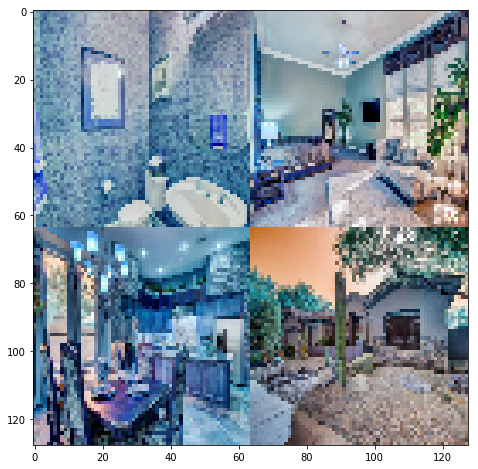

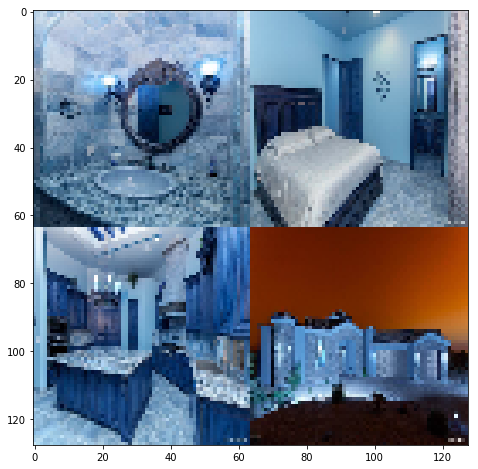

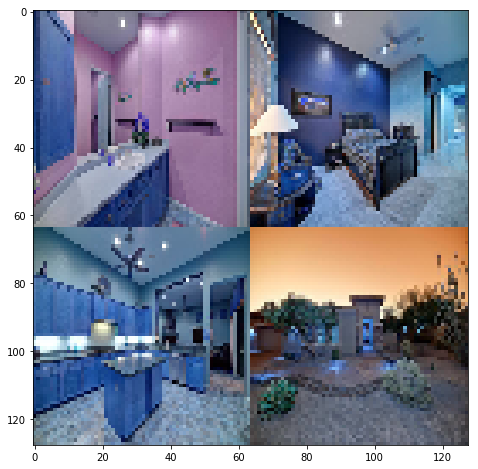

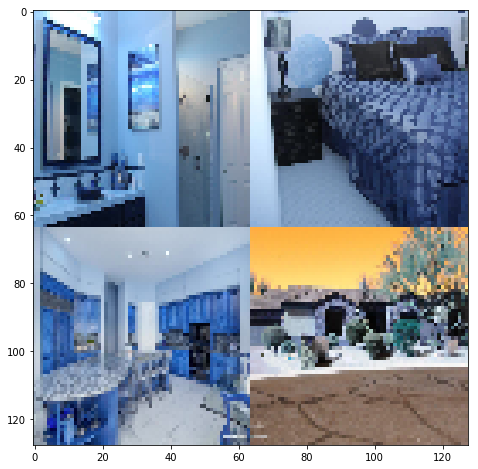

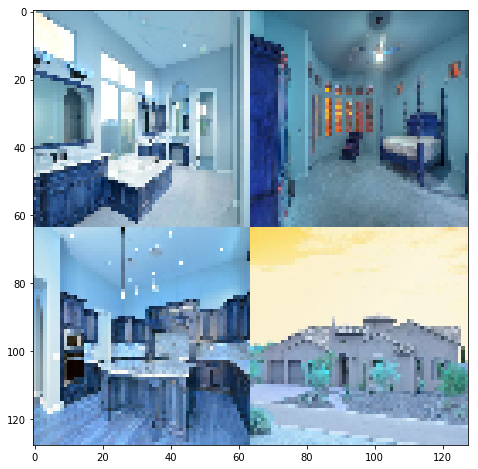

...

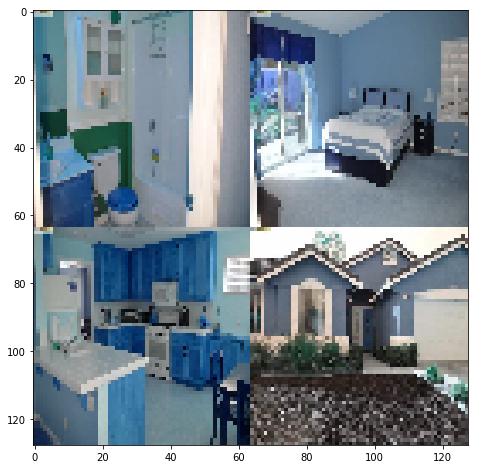

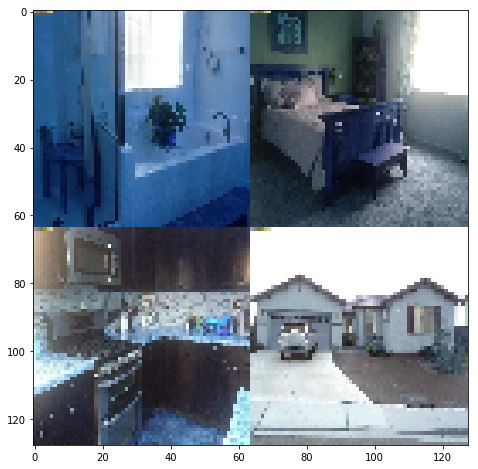

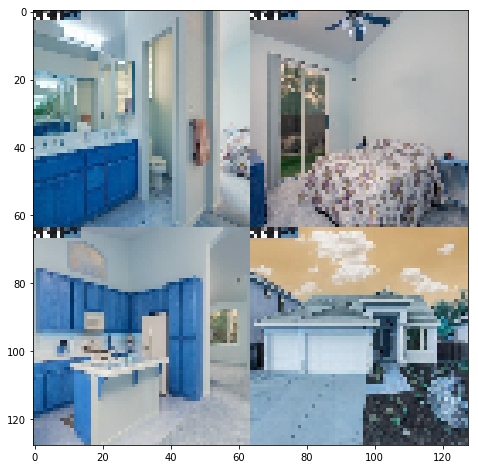

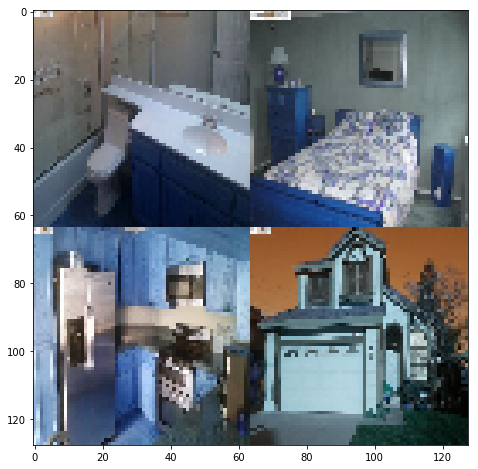

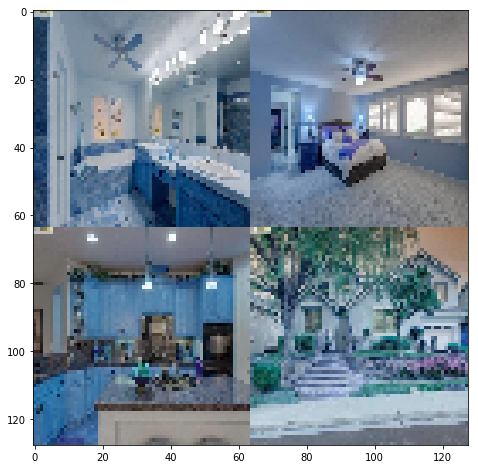

In [53]:
from matplotlib import pyplot as plt

for i in images_output:
     plt.figure(figsize=(8,8))
     plt.imshow(i, interpolation='nearest')
     plt.show()

## Create numpy arrays of images

In [54]:
img_arr=np.asarray(images_output)

In [55]:
img_arr.shape

(535, 128, 128, 3)

## Next, using functional API, you create DENSE and CNN models to feed text and image to them seperately. 

## Notice:  If you use CPU, it will take at least 1 hour for model training.   so please use google colab GPU.